# Batch 0 Image Analysis with initial CMU Model 
### Setting up environment


In [1]:
# Instance Segmentation of Powder Particles and Satellites

#%%

## regular module imports
import cv2
import json
import matplotlib.pyplot as plt
import numpy as np
import os
from pathlib import Path
import pickle
import skimage.io
import sys

## detectron2
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import (
    DatasetCatalog,
    MetadataCatalog,
)
from detectron2.engine import DefaultTrainer, DefaultPredictor
from detectron2.structures import BoxMode

## ampis
ampis_root = Path('../../../')
sys.path.append(str(ampis_root))

## Collecting Data


In [5]:
from ampis import data_utils, visualize


EXPERIMENT_NAME = 'satellite' # can be 'particle' or 'satellite'
json_path_train = Path('..', 'data','via_2.0.8/', f'via_powder_{EXPERIMENT_NAME}_training_W2.json')  # path to training data
json_path_val = Path('..','data','via_2.0.8/', f'via_powder_{EXPERIMENT_NAME}_validation_W2.json')  # path to training data

assert json_path_train.is_file(), 'training file not found!'
assert json_path_val.is_file(), 'validation file not found!'

## Model Configuration
This is where we specify the directory where the outputs are saved, various hyperparameters for the model, and more.

In [6]:
cfg = get_cfg() # initialize cfg object
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml'))  # load default parameters for Mask R-CNN
cfg.INPUT.MASK_FORMAT = 'polygon'  # masks generated in VGG image annotator are polygons
cfg.SOLVER.IMS_PER_BATCH = 1 # number of images per batch (across all machines)
cfg.SOLVER.CHECKPOINT_PERIOD = 400  # number of iterations after which to save model checkpoints
cfg.MODEL.DEVICE='cuda'  # 'cpu' to force model to run on cpu, 'cuda' if you have a compatible gpu
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # Since we are training separate models for particles and satellites there is only one class output
cfg.TEST.DETECTIONS_PER_IMAGE = 400 if EXPERIMENT_NAME == 'particle' else 150  # maximum number of instances that can be detected in an image (this is fixed in mask r-cnn)
cfg.OUTPUT_DIR = str(Path('..', f'{EXPERIMENT_NAME}_output'))
model_checkpoints = sorted(Path(cfg.OUTPUT_DIR).glob('*.pth'))  # paths to weights saved druing training
cfg.MODEL.WEIGHTS = str(model_checkpoints[-1])  # use the last model checkpoint saved during training. If you want to see the performance of other checkpoints you can select a different index from model_checkpoints.
predictor = DefaultPredictor(cfg)  # create predictor object

## Analyzing Images
Runs trained model on all 17 images of batch-0

Testing Image: sampleSet1Image0c.png


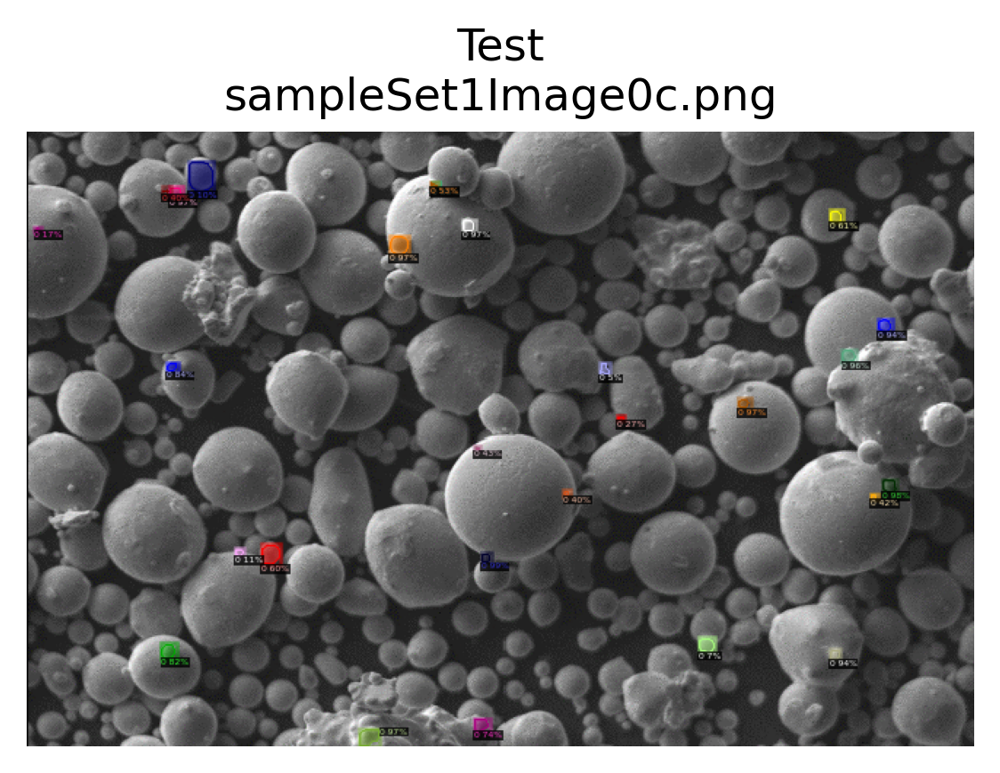

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image0c.png
	num_instances: 27
Testing Image: sampleSet1Image1c.png


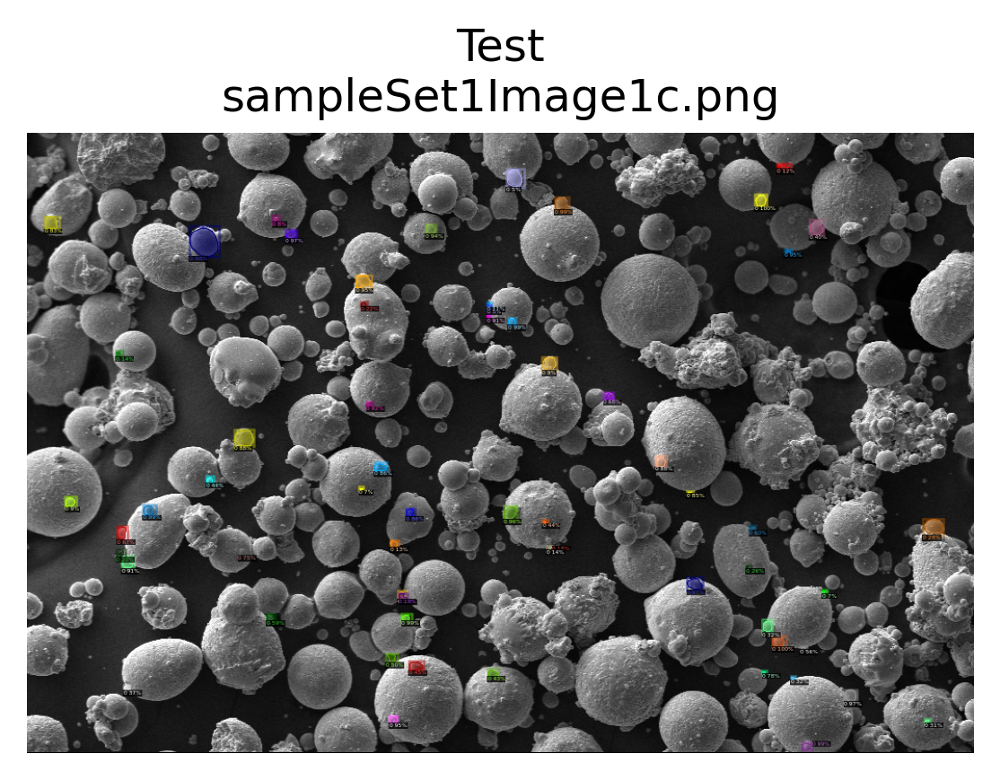

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image1c.png
	num_instances: 61
Testing Image: sampleSet1Image2c.png


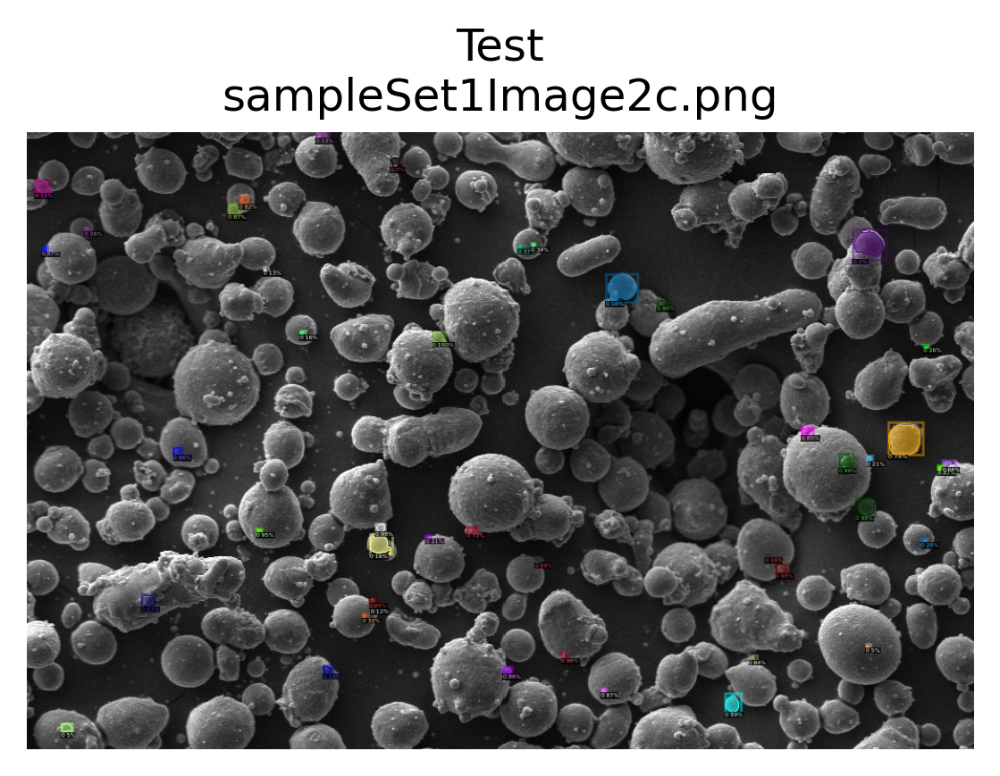

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image2c.png
	num_instances: 45
Testing Image: sampleSet1Image3c.png


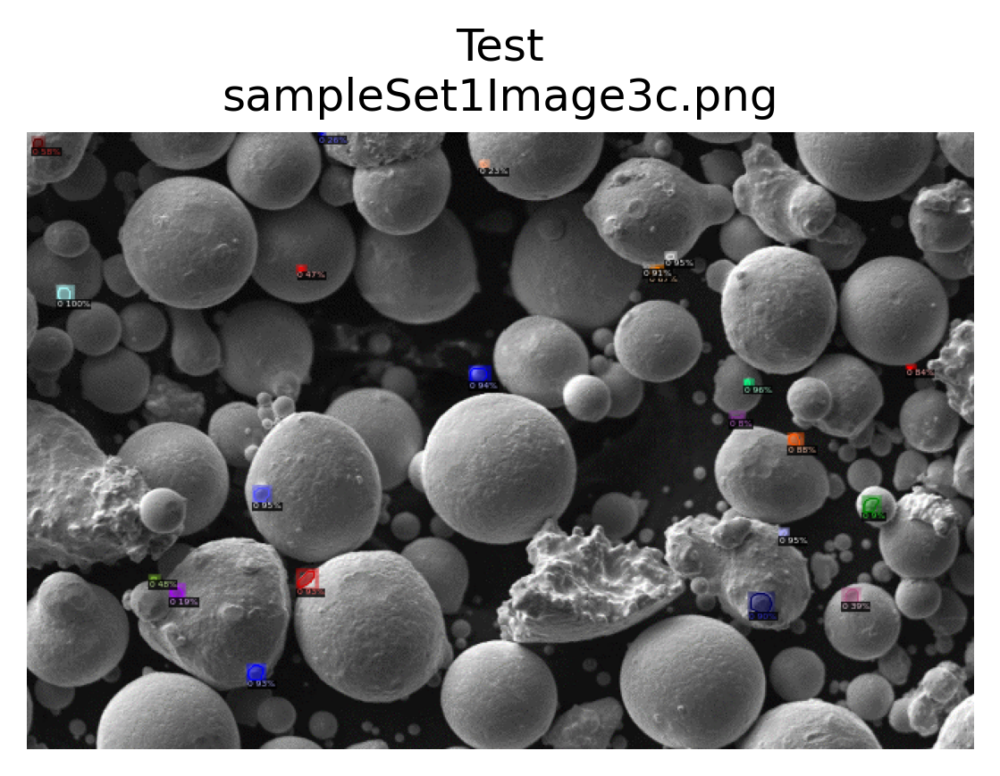

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image3c.png
	num_instances: 22
Testing Image: sampleSet1Image4c.png


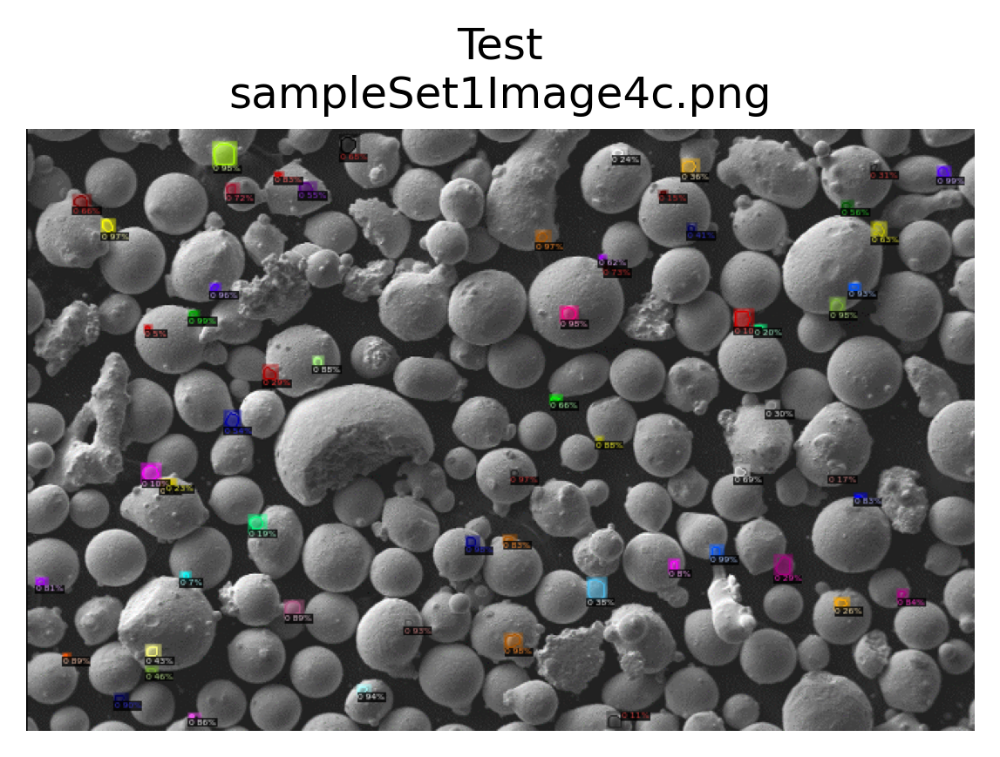

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image4c.png
	num_instances: 60
Testing Image: sampleSet1Image5c.png


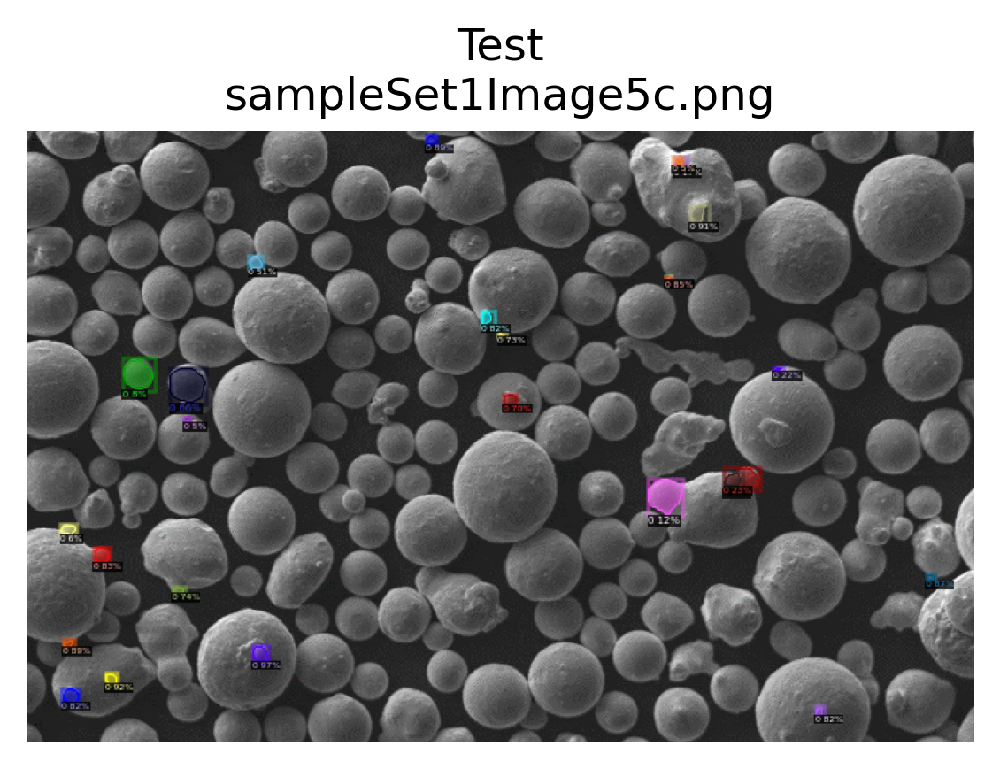

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image5c.png
	num_instances: 26
Testing Image: sampleSet1Image6c.png


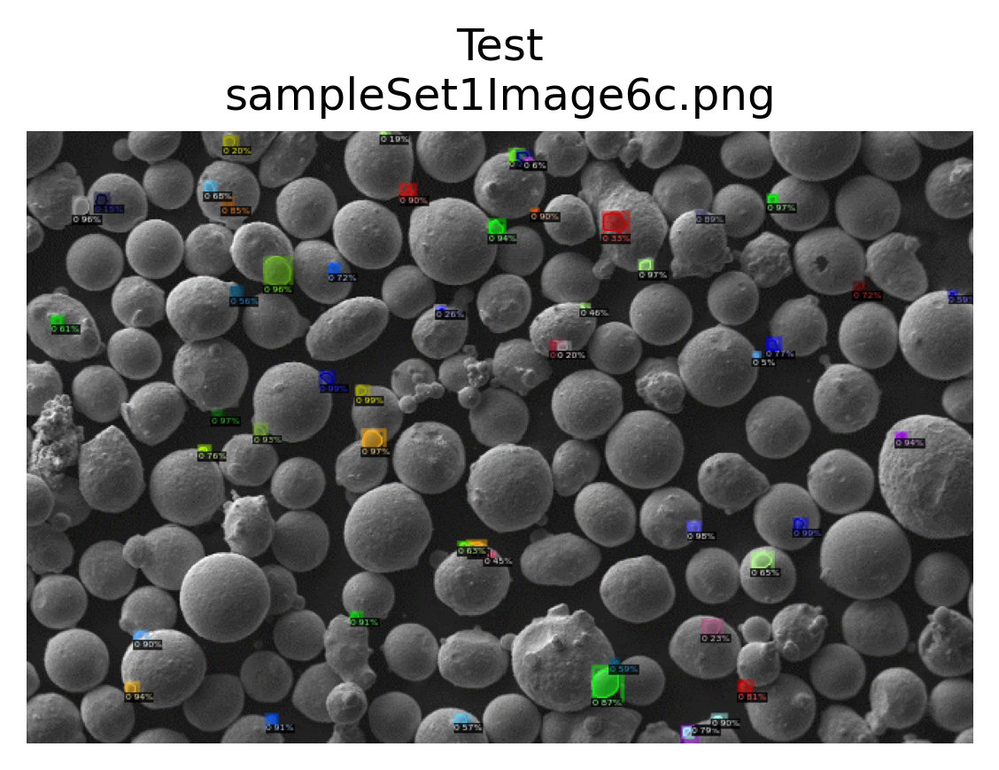

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image6c.png
	num_instances: 54
Testing Image: sampleSet1Image7c.png


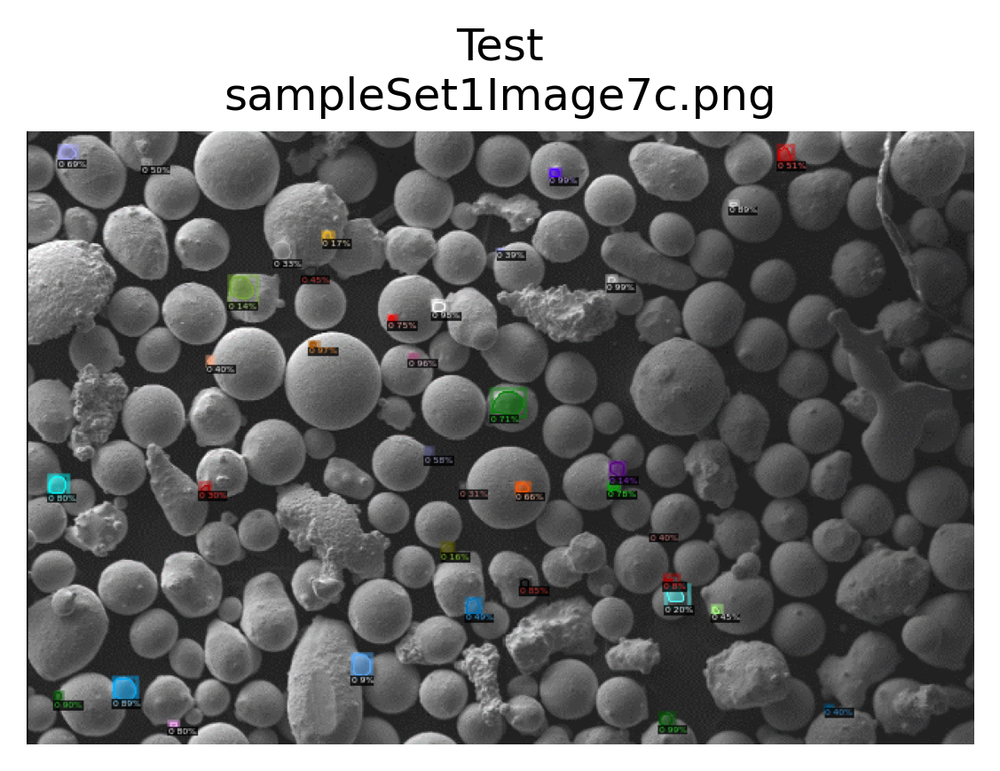

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image7c.png
	num_instances: 37
Testing Image: sampleSet1Image8c.png


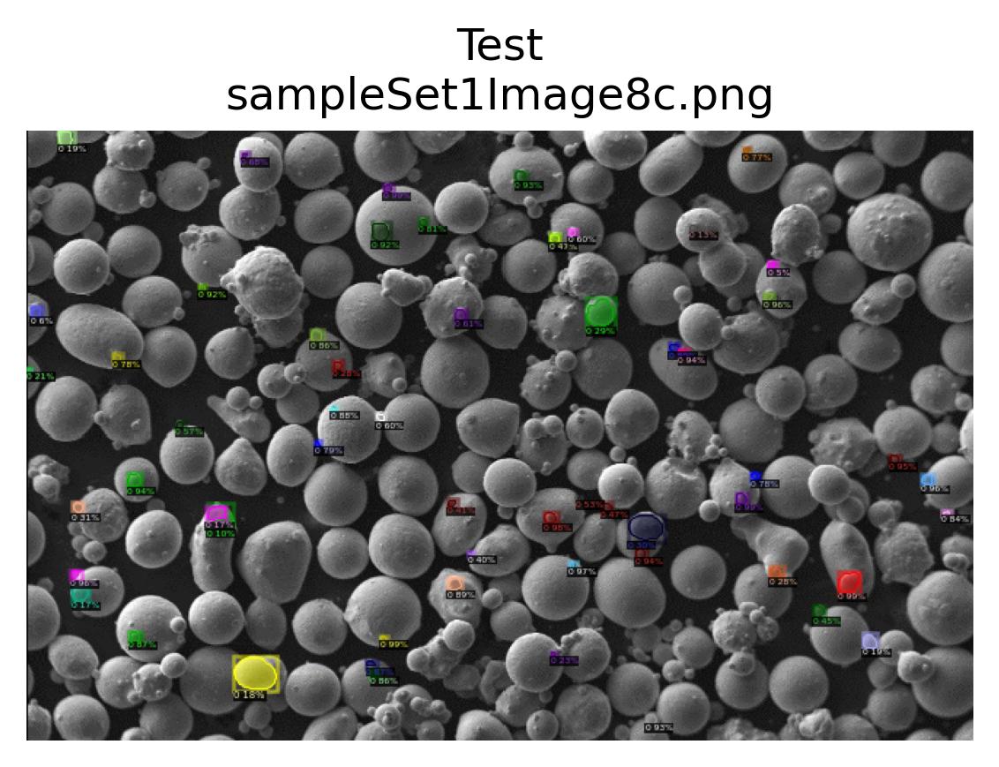

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image8c.png
	num_instances: 58
Testing Image: sampleSet1Image9c.png


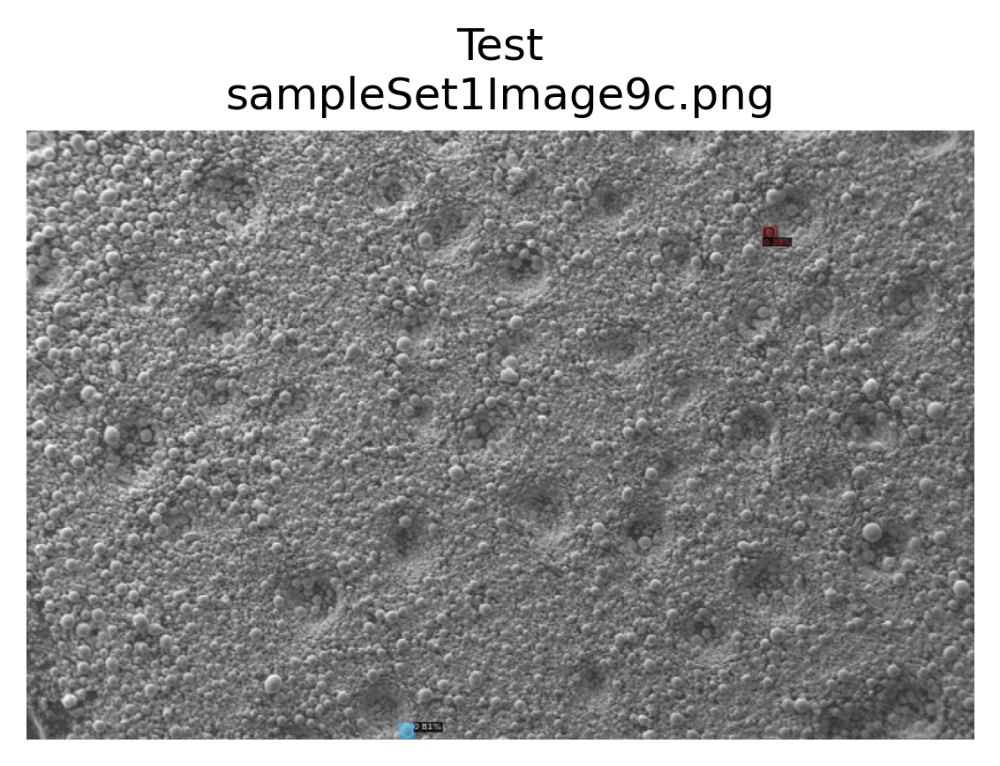

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image9c.png
	num_instances: 2
Testing Image: sampleSet1Image10c.png


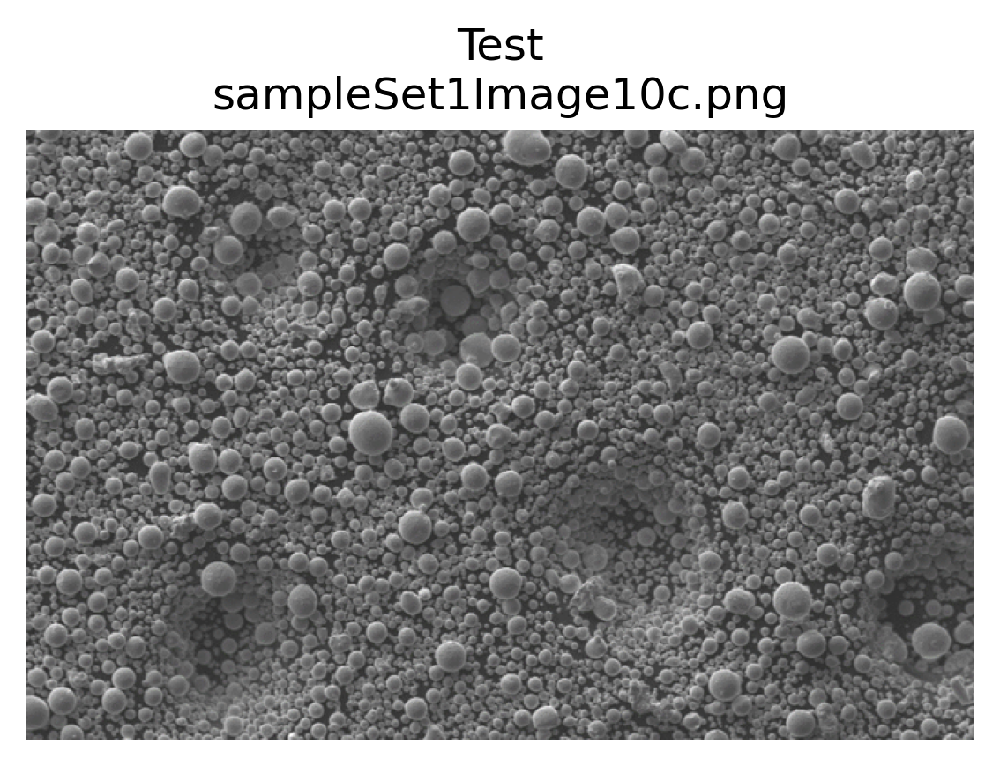

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image10c.png
	num_instances: 0
Testing Image: sampleSet1Image11c.png


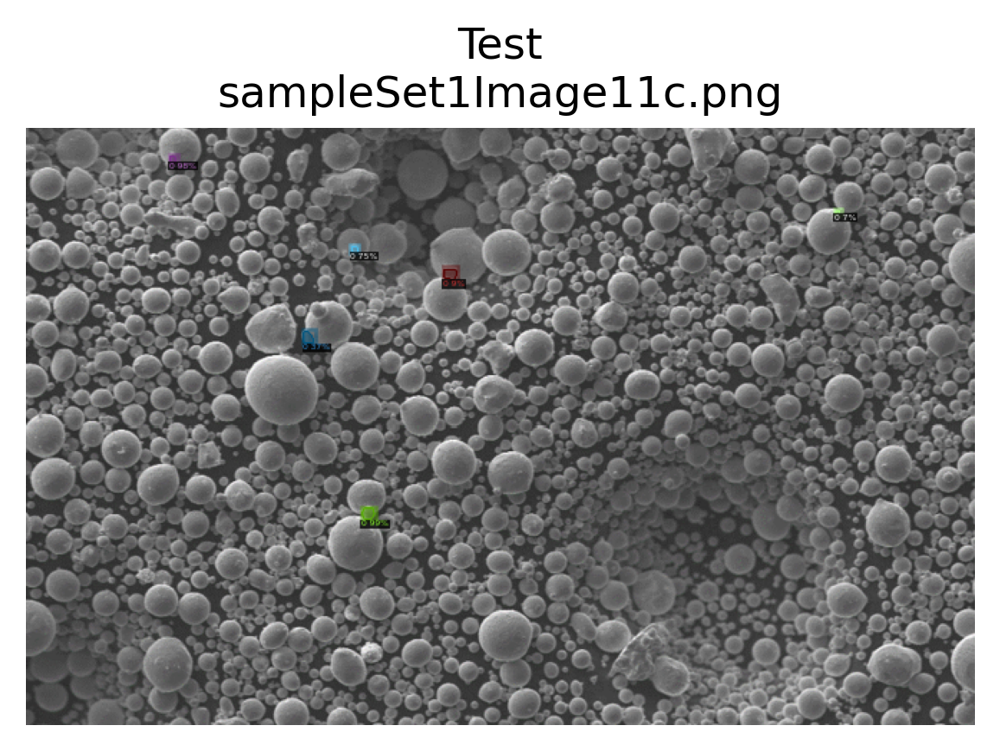

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image11c.png
	num_instances: 6
Testing Image: sampleSet1Image12c.png


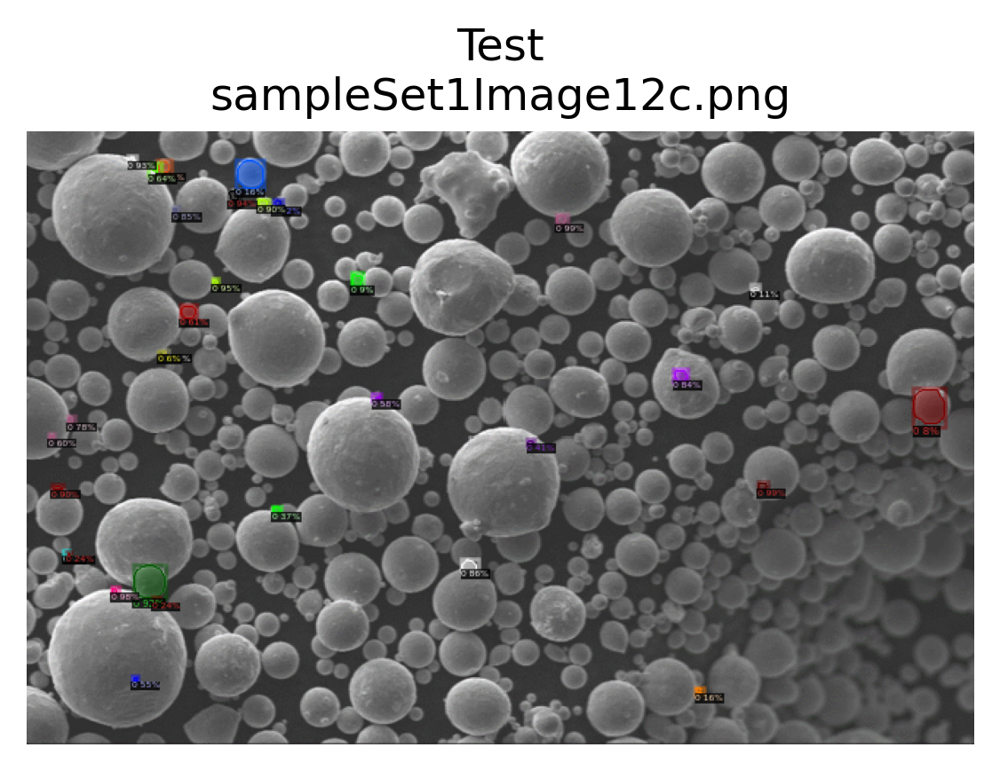

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image12c.png
	num_instances: 32
Testing Image: sampleSet1Image13c.png


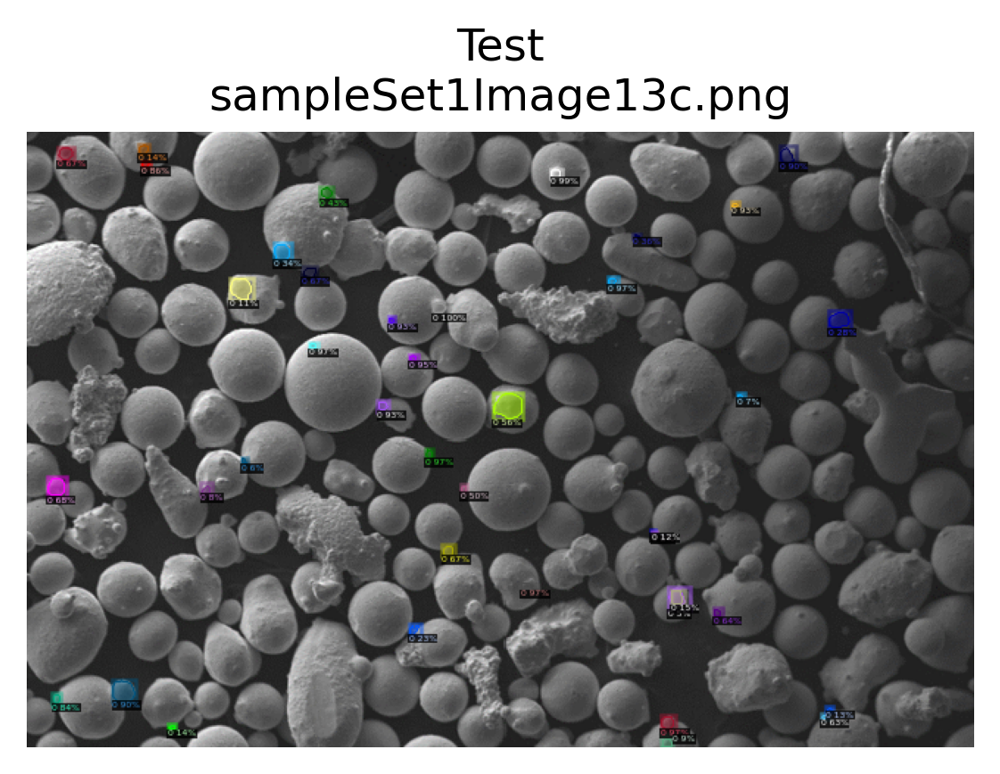

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image13c.png
	num_instances: 41
Testing Image: sampleSet1Image14c.png


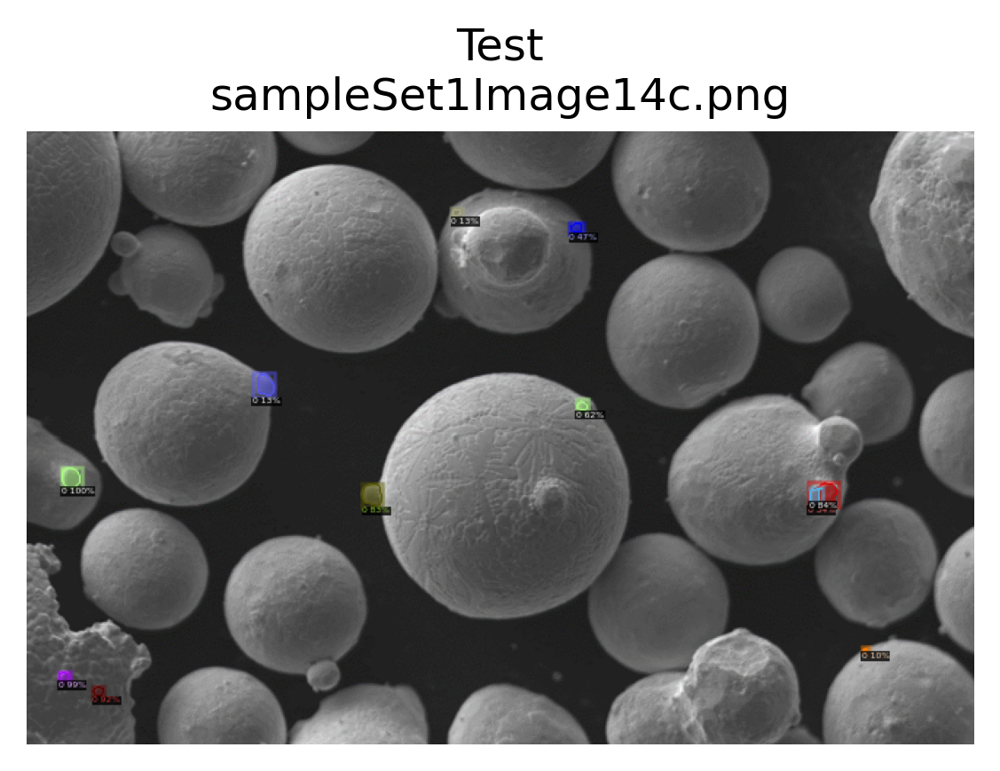

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image14c.png
	num_instances: 11
Testing Image: sampleSet1Image15c.png


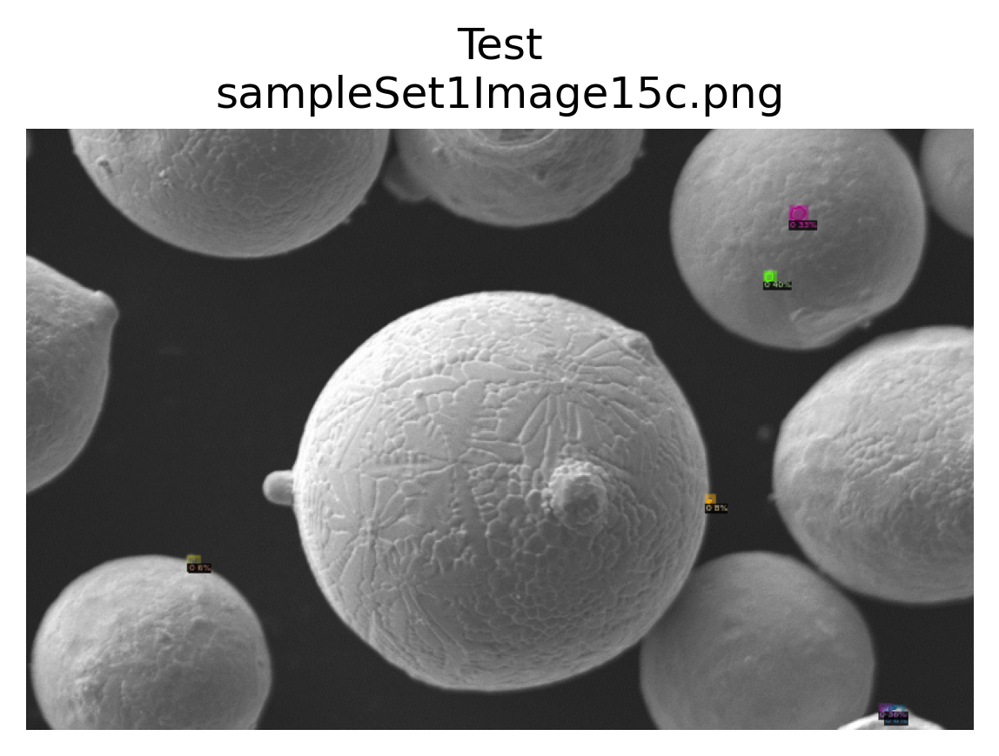

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image15c.png
	num_instances: 7
Testing Image: sampleSet1Image16c.png


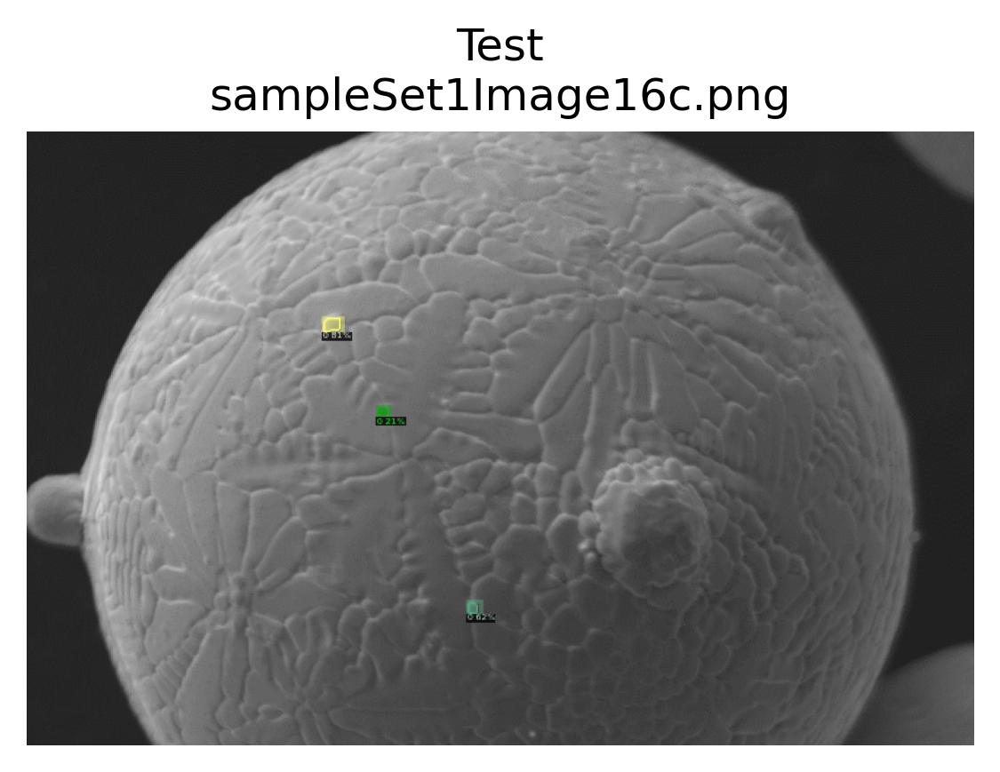

ddict info:
	path: ../data/images_png/AMPIS-Images/batch-0/sampleSet1Image16c.png
	num_instances: 3


In [7]:
imageSet = []
for i in range(17):
    tempSet = []
    imageName = "sampleSet1Image" + str(i) + "c.png"
    print("Testing Image: " + imageName)
    img_path = Path('..', 'data','images_png','AMPIS-Images', 'batch-0', imageName)
    img = cv2.imread(str(img_path))
    outs = predictor(img)
    data_utils.format_outputs(img_path, dataset='test', pred=outs)
    visualize.display_ddicts(ddict=outs,  # predictions to display
                             outpath=None, dataset='Test',  # don't save figure
                             gt=False,  # specifies format as model predictions
                            img_path=img_path)  # path to image'''